In [2]:
!pip install tensorly

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 229.7/229.7 kB 4.0 MB/s eta 0:00:00


In [18]:
from PIL import Image

# Open the image file
image = Image.open("2.JPG")

# Resize the image
resized_image = image.resize((640, 360))

# Save the resized image
resized_image.save("2_resized.jpg")


In [25]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
# Function to perform SVD and embed watermark
def embed_watermark(frame, watermark_img, alpha):
    # Perform SVD on the frame
    U, sigma, Vt = np.linalg.svd(frame, full_matrices=False)

    # Perform SVD on the watermark image
    U_wm, sigma_wm, Vt_wm = np.linalg.svd(watermark_img, full_matrices=False)

    # Embed the watermark by modifying the singular values
    sigma_new = sigma + alpha * sigma_wm

    # Reconstruct the frame with modified singular values
    frame_watermarked = np.dot(U, np.dot(np.diag(sigma_new), Vt))

    # Clip values to ensure they are within valid range for image
    frame_watermarked = np.clip(frame_watermarked, 0, 255).astype(np.uint8)

    return frame_watermarked

# Load the video
video_capture = cv2.VideoCapture('background.avi')

# Load the watermark image
watermark_img = cv2.imread('2_resized.jpg', cv2.IMREAD_GRAYSCALE)

# Set the watermark strength (alpha value)
alpha = 0.1

# Get the video frame width and height
frame_width = int(video_capture.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(video_capture.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Define the codec and create VideoWriter object
out = cv2.VideoWriter('background_with_watermark.avi', cv2.VideoWriter_fourcc(*'XVID'), 30, (frame_width, frame_height))

# Read until video is completed
while video_capture.isOpened():
    # Capture frame-by-frame
    ret, frame = video_capture.read()

    if ret:
        # Convert frame to grayscale
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Embed watermark into the frame
        frame_watermarked = embed_watermark(frame_gray, watermark_img, alpha)

        # Write the watermarked frame to output video file
        out.write(cv2.cvtColor(frame_watermarked, cv2.COLOR_GRAY2BGR))

        # Display the watermarked frame
        # cv2_imshow(frame_watermarked)

        # Press 'q' to exit
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    else:
        break

# Release VideoCapture and VideoWriter objects
video_capture.release()
out.release()

# Close all OpenCV windows
cv2.destroyAllWindows()


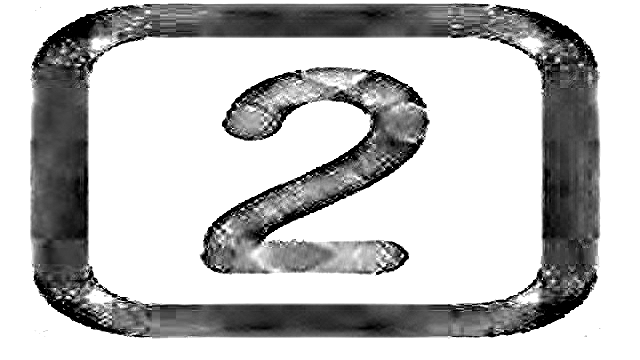

In [12]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

def extract_watermark(frame_watermarked, watermark_img, alpha):
    # Perform SVD on the watermarked frame
    U, sigma_watermarked, Vt = np.linalg.svd(frame_watermarked)

    # Perform SVD on the original watermark image
    U_wm, sigma_wm, Vt_wm = np.linalg.svd(watermark_img)

    # Calculate the difference in singular values to extract the watermark
    sigma_diff = (sigma_watermarked - alpha * sigma_wm) / alpha

    # Reconstruct the watermark image
    watermark_extracted = np.dot(U_wm[:, :len(sigma_diff)], np.dot(np.diag(sigma_diff), Vt_wm[:len(sigma_diff), :]))

    # Clip values to ensure they are within valid range for image
    watermark_extracted = np.clip(watermark_extracted, 0, 255).astype(np.uint8)

    return watermark_extracted




# Load the watermarked video
video_capture = cv2.VideoCapture('background_with_watermark.avi')

# Load the watermark image
watermark_img = cv2.imread('2_resized.jpg', cv2.IMREAD_GRAYSCALE)

# Set the watermark strength (alpha value)
alpha = 0.1

# Read the first frame of the video to extract the watermark
ret, frame = video_capture.read()

if ret:
    # Convert frame to grayscale
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Extract watermark from the first frame
    watermark_extracted = extract_watermark(frame_gray, watermark_img, alpha)

    # Save the extracted watermark image
    cv2.imwrite('extracted_watermark.png', watermark_extracted)

    # Display the extracted watermark
    cv2_imshow(watermark_extracted)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
else:
    print("Error reading video frame")

# Release VideoCapture object
video_capture.release()


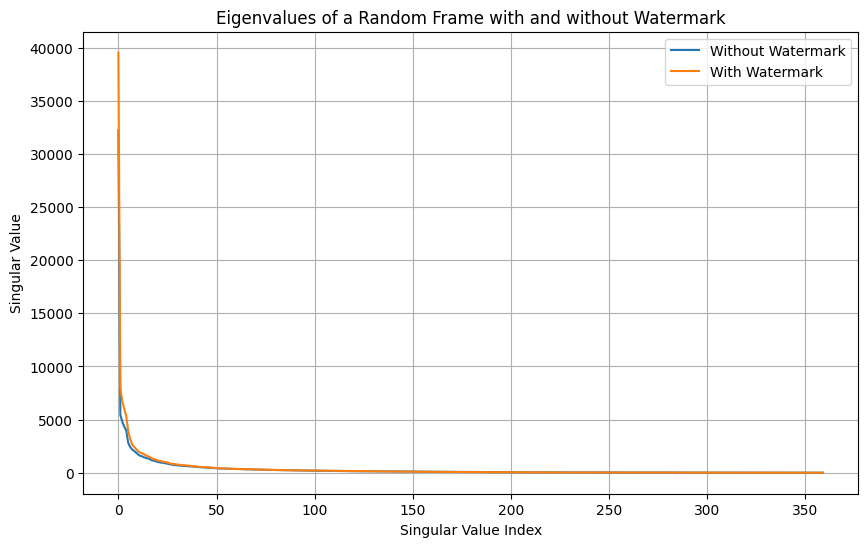

In [26]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Function to perform Singular Value Decomposition (SVD) and extract singular values
def get_singular_values(frame):
    # Perform SVD on the frame
    _, sigma, _ = np.linalg.svd(frame)

    return sigma

# Load the video clip with watermark
video_capture_with_watermark = cv2.VideoCapture('background_with_watermark.avi')

# Load the video clip without watermark
video_capture_without_watermark = cv2.VideoCapture('background.avi')

# Read a random frame from both video clips
frame_idx = np.random.randint(0, int(video_capture_with_watermark.get(cv2.CAP_PROP_FRAME_COUNT)))
video_capture_with_watermark.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
ret, frame_with_watermark = video_capture_with_watermark.read()

frame_idx = np.random.randint(0, int(video_capture_without_watermark.get(cv2.CAP_PROP_FRAME_COUNT)))
video_capture_without_watermark.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
ret, frame_without_watermark = video_capture_without_watermark.read()

# Convert frames to grayscale
frame_with_watermark_gray = cv2.cvtColor(frame_with_watermark, cv2.COLOR_BGR2GRAY)
frame_without_watermark_gray = cv2.cvtColor(frame_without_watermark, cv2.COLOR_BGR2GRAY)

# Get singular values for frames
singular_values_with_watermark = get_singular_values(frame_with_watermark_gray)
singular_values_without_watermark = get_singular_values(frame_without_watermark_gray)

# Plot the eigenvalues
plt.figure(figsize=(10, 6))
plt.plot(singular_values_without_watermark, label='Without Watermark')
plt.plot(singular_values_with_watermark, label='With Watermark')
plt.xlabel('Singular Value Index')
plt.ylabel('Singular Value')
plt.title('Eigenvalues of a Random Frame with and without Watermark')
plt.legend()
plt.grid(True)
plt.show()

# Release video capture objects
video_capture_with_watermark.release()
video_capture_without_watermark.release()


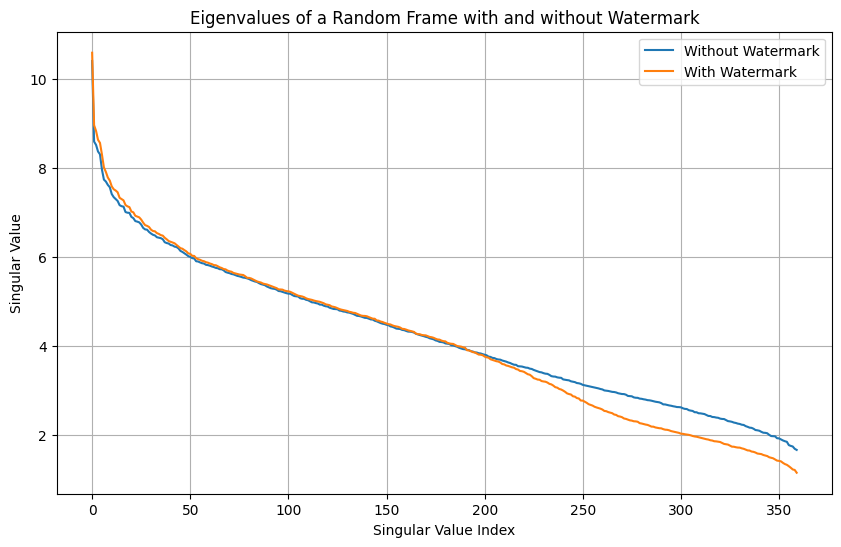

In [32]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Function to perform Singular Value Decomposition (SVD) and extract singular values
def get_singular_values(frame):
    # Perform SVD on the frame
    _, sigma, _ = np.linalg.svd(frame)

    return sigma

# Load the video clip with watermark
video_capture_with_watermark = cv2.VideoCapture('background_with_watermark.avi')

# Load the video clip without watermark
video_capture_without_watermark = cv2.VideoCapture('background.avi')

# Read a random frame from both video clips
frame_idx = np.random.randint(0, int(video_capture_with_watermark.get(cv2.CAP_PROP_FRAME_COUNT)))
video_capture_with_watermark.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
ret, frame_with_watermark = video_capture_with_watermark.read()

frame_idx = np.random.randint(0, int(video_capture_without_watermark.get(cv2.CAP_PROP_FRAME_COUNT)))
video_capture_without_watermark.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
ret, frame_without_watermark = video_capture_without_watermark.read()

# Convert frames to grayscale
frame_with_watermark_gray = cv2.cvtColor(frame_with_watermark, cv2.COLOR_BGR2GRAY)
frame_without_watermark_gray = cv2.cvtColor(frame_without_watermark, cv2.COLOR_BGR2GRAY)

# Get singular values for frames
singular_values_with_watermark = get_singular_values(frame_with_watermark_gray)
singular_values_without_watermark = get_singular_values(frame_without_watermark_gray)

# Plot the eigenvalues
plt.figure(figsize=(10, 6))
plt.plot(np.log(singular_values_without_watermark), label='Without Watermark')
plt.plot(np.log(singular_values_with_watermark), label='With Watermark')
plt.xlabel('Singular Value Index')
plt.ylabel('Singular Value')
plt.title('Eigenvalues of a Random Frame with and without Watermark')
plt.legend()
plt.grid(True)
plt.show()

# Release video capture objects
video_capture_with_watermark.release()
video_capture_without_watermark.release()


Frame with Watermark


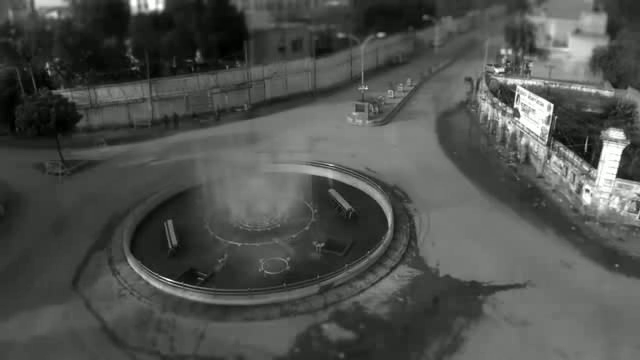

Frame without Watermark


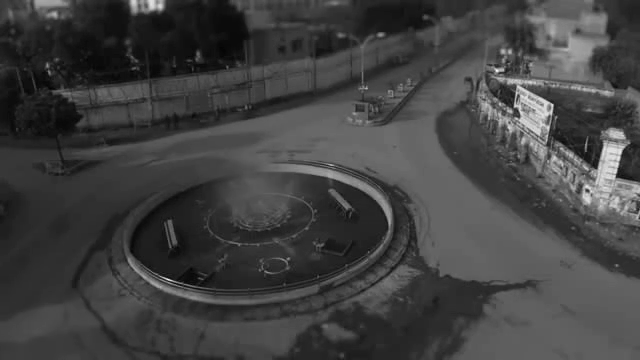

In [31]:
import cv2
import numpy as np

# Function to display a frame
def display_frame(frame, window_name='Frame'):
    print(window_name)
    cv2_imshow(frame)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

# Load the video clip with watermark
video_capture_with_watermark = cv2.VideoCapture('background_with_watermark.avi')

# Load the video clip without watermark
video_capture_without_watermark = cv2.VideoCapture('background.avi')
# Get the total number of frames in each video clip
total_frames_with_watermark = int(video_capture_with_watermark.get(cv2.CAP_PROP_FRAME_COUNT))
total_frames_without_watermark = int(video_capture_without_watermark.get(cv2.CAP_PROP_FRAME_COUNT))

# Select a random frame index for each video clip
random_frame_idx_with_watermark = np.random.randint(0, total_frames_with_watermark)
random_frame_idx_without_watermark = np.random.randint(0, total_frames_without_watermark)

# Set the random frame indices for each video clip
video_capture_with_watermark.set(cv2.CAP_PROP_POS_FRAMES, random_frame_idx_with_watermark)
video_capture_without_watermark.set(cv2.CAP_PROP_POS_FRAMES, random_frame_idx_without_watermark)

# Read the random frames
ret, frame_with_watermark = video_capture_with_watermark.read()
ret, frame_without_watermark = video_capture_without_watermark.read()

# Display the random frames
display_frame(frame_with_watermark, window_name='Frame with Watermark')
display_frame(frame_without_watermark, window_name='Frame without Watermark')

# Release video capture objects
video_capture_with_watermark.release()
video_capture_without_watermark.release()


In [38]:
import cv2

# Load the input video
video_capture = cv2.VideoCapture('background_with_watermark.avi')

# Get the frame width and height
frame_width = int(video_capture.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(video_capture.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Define the codec and create VideoWriter object
out = cv2.VideoWriter('blured-background-watermarked.avi', cv2.VideoWriter_fourcc(*'XVID'), 30, (frame_width, frame_height))

# Process each frame of the video
while video_capture.isOpened():
    ret, frame = video_capture.read()

    if ret:
        # Apply Gaussian blur with kernel size 5 and sigma 0.4
        blurred_frame = cv2.GaussianBlur(frame, (7, 7), 0.6)

        # Write the blurred frame to the output video file
        out.write(blurred_frame)
    else:
        break

# Release VideoCapture and VideoWriter objects
video_capture.release()
out.release()


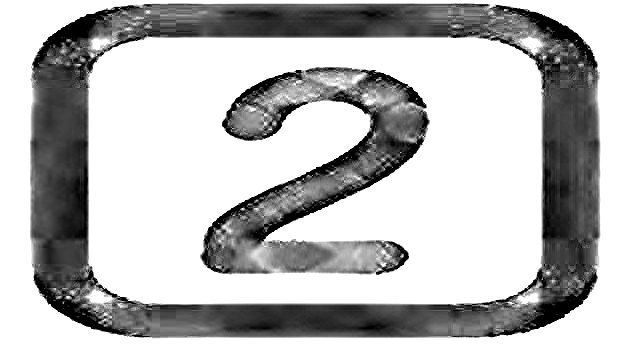

In [39]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

def extract_watermark(frame_watermarked, watermark_img, alpha):
    # Perform SVD on the watermarked frame
    U, sigma_watermarked, Vt = np.linalg.svd(frame_watermarked)

    # Perform SVD on the original watermark image
    U_wm, sigma_wm, Vt_wm = np.linalg.svd(watermark_img)

    # Calculate the difference in singular values to extract the watermark
    sigma_diff = (sigma_watermarked - alpha * sigma_wm) / alpha

    # Reconstruct the watermark image
    watermark_extracted = np.dot(U_wm[:, :len(sigma_diff)], np.dot(np.diag(sigma_diff), Vt_wm[:len(sigma_diff), :]))

    # Clip values to ensure they are within valid range for image
    watermark_extracted = np.clip(watermark_extracted, 0, 255).astype(np.uint8)

    return watermark_extracted




# Load the watermarked video
video_capture = cv2.VideoCapture('blured-background-watermarked.avi')

# Load the watermark image
watermark_img = cv2.imread('2_resized.jpg', cv2.IMREAD_GRAYSCALE)

# Set the watermark strength (alpha value)
alpha = 0.1

# Read the first frame of the video to extract the watermark
ret, frame = video_capture.read()

if ret:
    # Convert frame to grayscale
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Extract watermark from the first frame
    watermark_extracted = extract_watermark(frame_gray, watermark_img, alpha)

    # Save the extracted watermark image
    cv2.imwrite('extracted_watermark.png', watermark_extracted)

    # Display the extracted watermark
    cv2_imshow(watermark_extracted)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
else:
    print("Error reading video frame")

# Release VideoCapture object
video_capture.release()


In [24]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
# Function to perform SVD and embed watermark
def embed_watermark(A, W, a):
    U1, S1, V1 = np.linalg.svd(A, full_matrices=False)

    # Create a new matrix of zeros with the desired size
    new_S1 = np.zeros((360, 640))
    # Convert S1 to a diagonal matrix with its values along the diagonal
    S1_diag = np.diag(S1)

    # Copy the diagonal matrix to the upper-left corner of the new matrix
    new_S1[:320, :320] = S1_diag[:320, :320]

    temp = new_S1 + (a * W)
    Uw, Sw, Vw = np.linalg.svd(temp, full_matrices=False)
    Aw = np.dot(U1, np.dot(np.diag(Sw), V1))

    # Clip values to ensure they are within valid range for image
    Aw = np.clip(Aw, 0, 255).astype(np.uint8)

    return Aw

# Load the video
video_capture = cv2.VideoCapture('background.avi')

# Load the watermark image
watermark_img = cv2.imread('2_resized.jpg', cv2.IMREAD_GRAYSCALE)

# Set the watermark strength (alpha value)
alpha = 0.1

# Get the video frame width and height
frame_width = int(video_capture.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(video_capture.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Define the codec and create VideoWriter object
out = cv2.VideoWriter('background_with_watermark_v2.avi', cv2.VideoWriter_fourcc(*'XVID'), 30, (frame_width, frame_height))

# Read until video is completed
while video_capture.isOpened():
    # Capture frame-by-frame
    ret, frame = video_capture.read()

    if ret:
        # Convert frame to grayscale
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Embed watermark into the frame
        frame_watermarked = embed_watermark(frame_gray, watermark_img, alpha)

        # Write the watermarked frame to output video file
        out.write(cv2.cvtColor(frame_watermarked, cv2.COLOR_GRAY2BGR))

        # Display the watermarked frame
        # cv2_imshow(frame_watermarked)

        # Press 'q' to exit
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    else:
        break

# Release VideoCapture and VideoWriter objects
video_capture.release()
out.release()

# Close all OpenCV windows
cv2.destroyAllWindows()


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

def svd_watermark_image(A, W, a):
    U1, S1, V1 = np.linalg.svd(A, full_matrices=False)

    # Create a new matrix of zeros with the desired size
    new_S1 = np.zeros((360, 640))
    # Convert S1 to a diagonal matrix with its values along the diagonal
    S1_diag = np.diag(S1)

    # Copy the diagonal matrix to the upper-left corner of the new matrix
    new_S1[:320, :320] = S1_diag[:320, :320]

    temp = new_S1 + (a * W)
    Uw, Sw, Vw = np.linalg.svd(temp, full_matrices=False)
    Aw = np.dot(U1, np.dot(np.diag(Sw), V1))
    chck =np.dot(np.diag(Sw), V1)
    Uw1, Sw1, Vw1 = np.linalg.svd(Aw, full_matrices=False)
    D = np.dot(Uw, np.dot(np.diag(Sw1), Vw))
    extracted_watermark = (D - new_S1) / a
    return extracted_watermark

# Read video
cap = cv2.VideoCapture('background.avi')
frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
# Load the watermark image
watermark_img = cv2.imread('2_resized.jpg', cv2.IMREAD_GRAYSCALE)
# Get the size of the image
height, width = watermark_img.shape[:2]



# Parameters for watermarking
a = 0.1  # Example scaling factor (replace it with your scaling factor)

# Process each frame
for i in range(frame_count):
    ret, frame = cap.read()
    if not ret:
        break

    # Convert frame to grayscale
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Apply watermarking algorithm to frame
    watermark_embeded = svd_watermark_image(frame_gray, watermark_img, a)

    cv2_imshow(watermark_embeded)
    if cv2.waitKey(25) & 0xFF == ord('q'):
        break

cap.release()

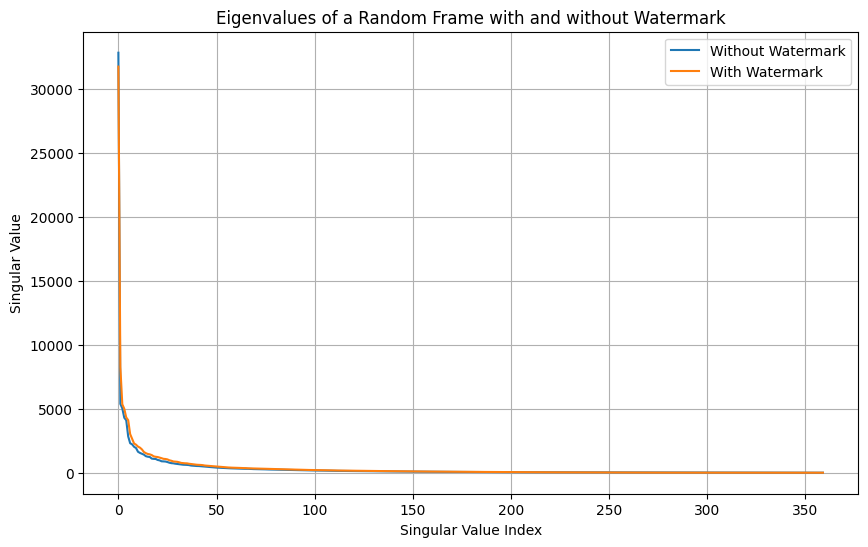

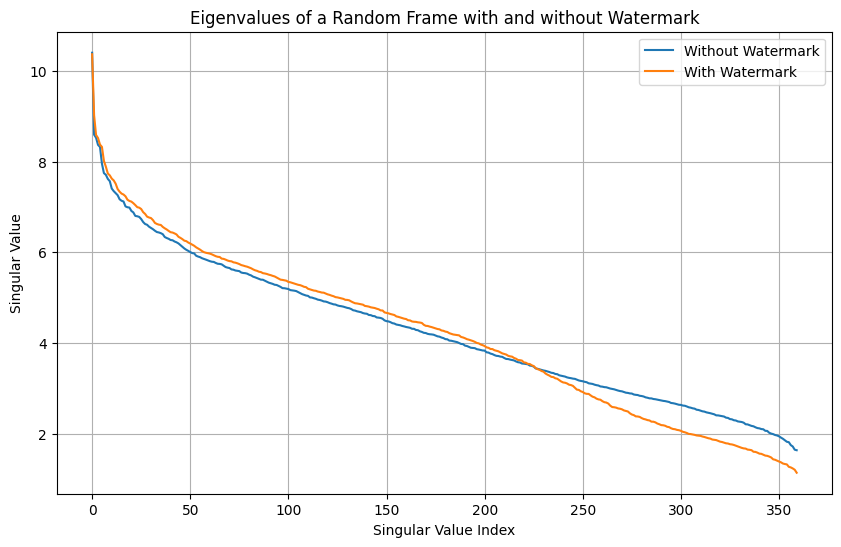

In [42]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Function to perform Singular Value Decomposition (SVD) and extract singular values
def get_singular_values(frame):
    # Perform SVD on the frame
    _, sigma, _ = np.linalg.svd(frame)

    return sigma

# Load the video clip with watermark
video_capture_with_watermark = cv2.VideoCapture('background_with_watermark_v2.avi')

# Load the video clip without watermark
video_capture_without_watermark = cv2.VideoCapture('background.avi')

# Read a random frame from both video clips
frame_idx = np.random.randint(0, int(video_capture_with_watermark.get(cv2.CAP_PROP_FRAME_COUNT)))
video_capture_with_watermark.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
ret, frame_with_watermark = video_capture_with_watermark.read()

frame_idx = np.random.randint(0, int(video_capture_without_watermark.get(cv2.CAP_PROP_FRAME_COUNT)))
video_capture_without_watermark.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)
ret, frame_without_watermark = video_capture_without_watermark.read()

# Convert frames to grayscale
frame_with_watermark_gray = cv2.cvtColor(frame_with_watermark, cv2.COLOR_BGR2GRAY)
frame_without_watermark_gray = cv2.cvtColor(frame_without_watermark, cv2.COLOR_BGR2GRAY)

# Get singular values for frames
singular_values_with_watermark = get_singular_values(frame_with_watermark_gray)
singular_values_without_watermark = get_singular_values(frame_without_watermark_gray)

# Plot the eigenvalues
plt.figure(figsize=(10, 6))
plt.plot(singular_values_without_watermark, label='Without Watermark')
plt.plot(singular_values_with_watermark, label='With Watermark')
plt.xlabel('Singular Value Index')
plt.ylabel('Singular Value')
plt.title('Eigenvalues of a Random Frame with and without Watermark')
plt.legend()
plt.grid(True)
plt.show()
# Plot the eigenvalues
plt.figure(figsize=(10, 6))
plt.plot(np.log(singular_values_without_watermark), label='Without Watermark')
plt.plot(np.log(singular_values_with_watermark), label='With Watermark')
plt.xlabel('Singular Value Index')
plt.ylabel('Singular Value')
plt.title('Eigenvalues of a Random Frame with and without Watermark')
plt.legend()
plt.grid(True)
plt.show()
# Release video capture objects
video_capture_with_watermark.release()
video_capture_without_watermark.release()


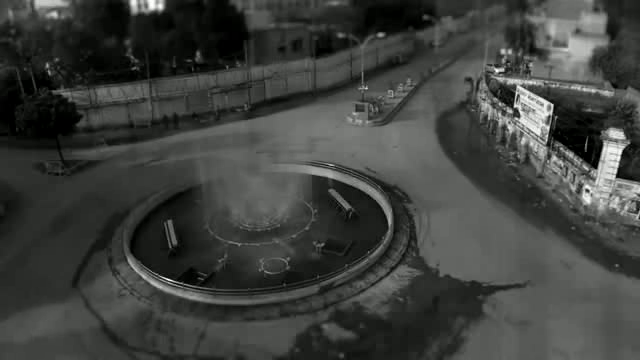

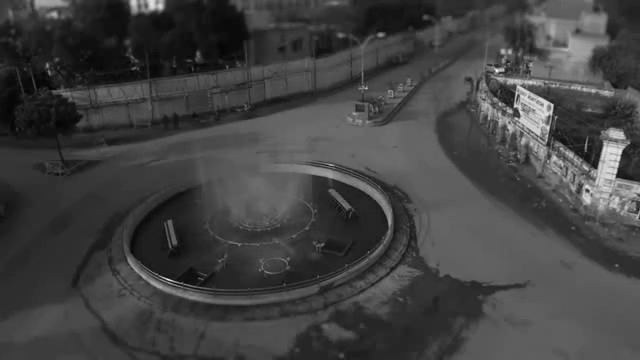

In [52]:
import cv2
import random

# Open the video file
video_path = 'background_with_watermark_v2.avi'
cap = cv2.VideoCapture(video_path)

# Get total number of frames
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

# Generate a random frame number
random_frame_number = random.randint(0, total_frames)

# Set the frame number
cap.set(cv2.CAP_PROP_POS_FRAMES, random_frame_number)

# Read the frame
ret, frame = cap.read()

# Check if frame is read successfully
if ret:
    # Display the frame
    cv2_imshow( frame)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
else:
    print("Error reading frame")

# Release the video capture object
cap.release()
video_capture_without_watermark = cv2.VideoCapture('background.avi')

# Open the video file
video_path = 'background.avi'
cap = cv2.VideoCapture(video_path)

# Set the frame number
cap.set(cv2.CAP_PROP_POS_FRAMES, random_frame_number)

# Read the frame
ret, frame = cap.read()

# Check if frame is read successfully
if ret:
    # Display the frame
    cv2_imshow( frame)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
else:
    print("Error reading frame")

# Release the video capture object
cap.release()

In [54]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
# Function to perform SVD and embed watermark
def embed_watermark(A, W, a):
    U1, S1, V1 = np.linalg.svd(A, full_matrices=False)

    # Create a new matrix of zeros with the desired size
    new_S1 = np.zeros((360, 640))
    # Convert S1 to a diagonal matrix with its values along the diagonal
    S1_diag = np.diag(S1)

    # Copy the diagonal matrix to the upper-left corner of the new matrix
    new_S1[:320, :320] = S1_diag[:320, :320]

    temp = new_S1 + (a * W)
    Uw, Sw, Vw = np.linalg.svd(temp, full_matrices=False)
    Aw = np.dot(U1, np.dot(np.diag(Sw), V1))

    # Clip values to ensure they are within valid range for image
    Aw = np.clip(Aw, 0, 255).astype(np.uint8)

    return Aw

# Load the video
video_capture = cv2.VideoCapture('background.avi')

# Load the watermark image
watermark_img = cv2.imread('2_resized.jpg', cv2.IMREAD_GRAYSCALE)

# Set the watermark strength (alpha value)
alpha = 0.1

# Get the video frame width and height
frame_width = int(video_capture.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(video_capture.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Define the codec and create VideoWriter object
out = cv2.VideoWriter('blured-background-watermarked.avi', cv2.VideoWriter_fourcc(*'XVID'), 30, (frame_width, frame_height))

# Read until video is completed
while video_capture.isOpened():
    # Capture frame-by-frame
    ret, frame = video_capture.read()

    if ret:
        # Convert frame to grayscale
        frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Embed watermark into the frame
        frame_watermarked = embed_watermark(frame_gray, watermark_img, alpha)
        blurred_frame = cv2.GaussianBlur(frame_watermarked, (7, 7), 0.6)

        # Write the watermarked frame to output video file
        out.write(cv2.cvtColor(blurred_frame, cv2.COLOR_GRAY2BGR))

        # Display the watermarked frame
        # cv2_imshow(frame_watermarked)

        # Press 'q' to exit
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    else:
        break

# Release VideoCapture and VideoWriter objects
video_capture.release()
out.release()

# Close all OpenCV windows
cv2.destroyAllWindows()


In [ ]:
import cv2

# Load the input video
video_capture = cv2.VideoCapture('background_with_watermark.avi')

# Get the frame width and height
frame_width = int(video_capture.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(video_capture.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Define the codec and create VideoWriter object
out = cv2.VideoWriter('blured-background-watermarked.avi', cv2.VideoWriter_fourcc(*'XVID'), 30, (frame_width, frame_height))

# Process each frame of the video
while video_capture.isOpened():
    ret, frame = video_capture.read()

    if ret:
        # Apply Gaussian blur with kernel size 5 and sigma 0.4
        blurred_frame = cv2.GaussianBlur(frame, (7, 7), 0.6)

        # Write the blurred frame to the output video file
        out.write(blurred_frame)
    else:
        break

# Release VideoCapture and VideoWriter objects
video_capture.release()
out.release()


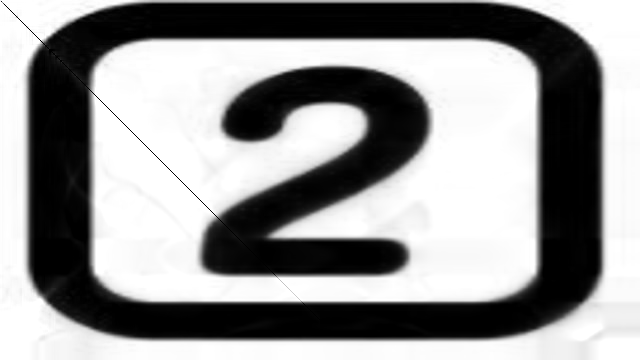

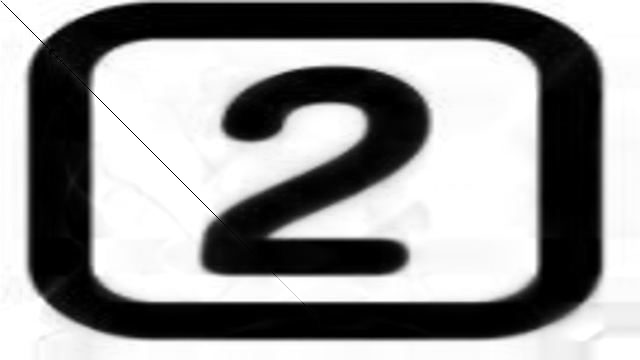

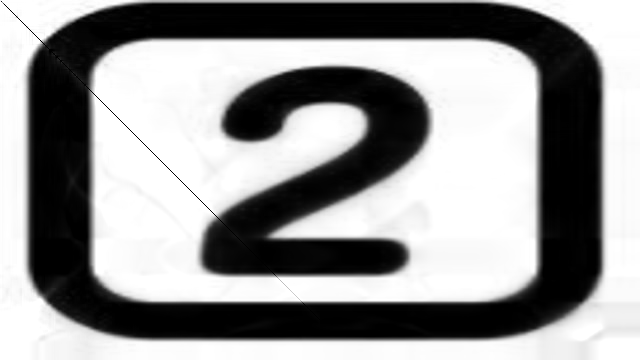

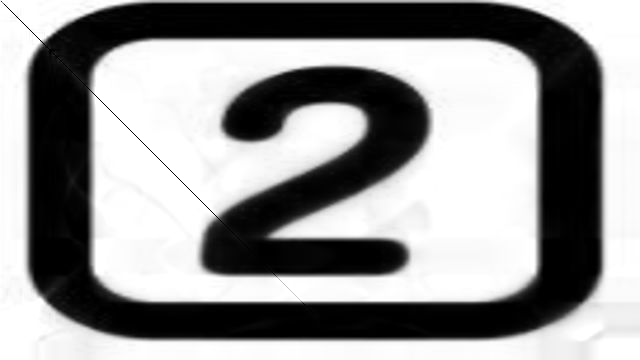

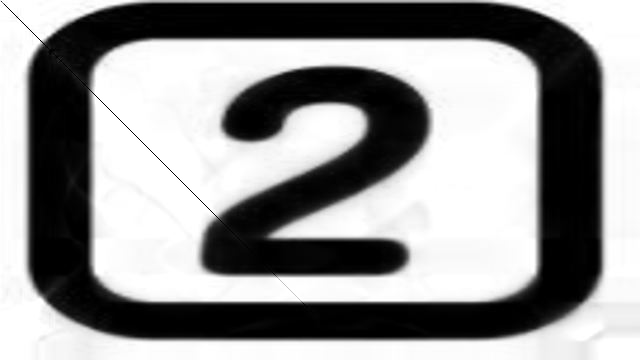

...

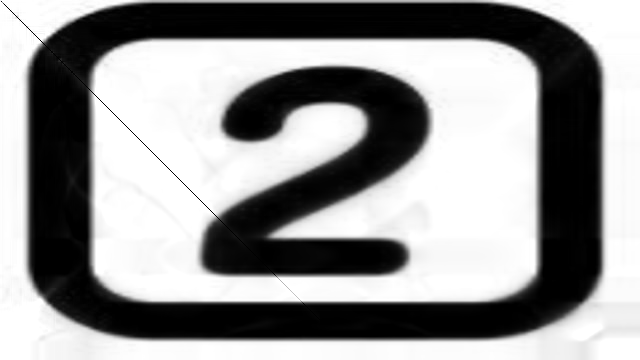

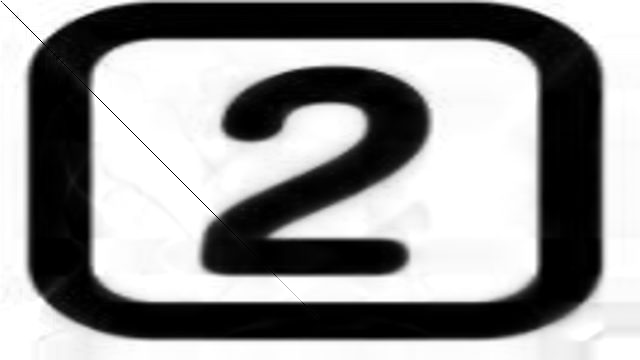

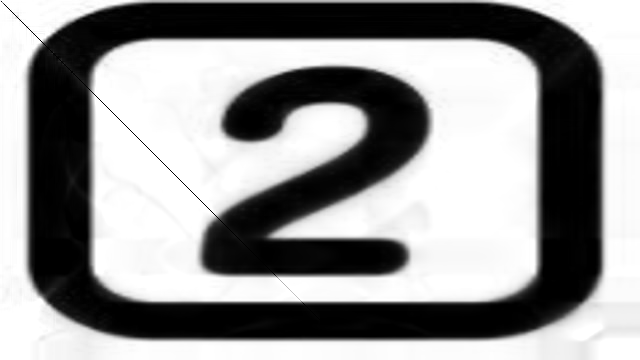

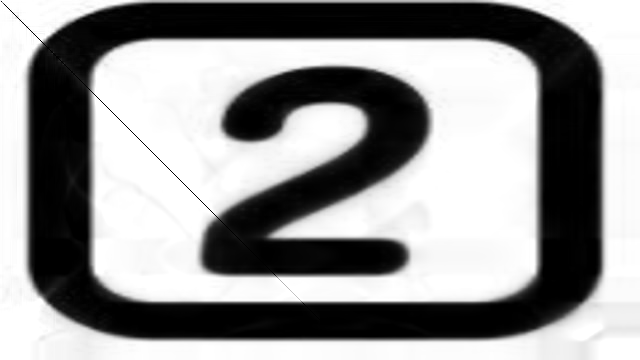

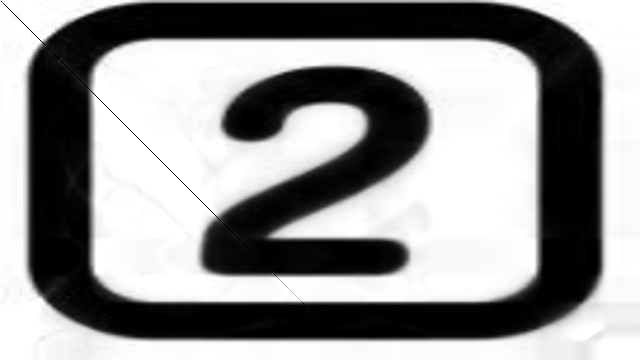

In [56]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

def svd_watermark_image(A, W, a):
    U1, S1, V1 = np.linalg.svd(A, full_matrices=False)

    # Create a new matrix of zeros with the desired size
    new_S1 = np.zeros((360, 640))
    # Convert S1 to a diagonal matrix with its values along the diagonal
    S1_diag = np.diag(S1)

    # Copy the diagonal matrix to the upper-left corner of the new matrix
    new_S1[:320, :320] = S1_diag[:320, :320]

    temp = new_S1 + (a * W)
    Uw, Sw, Vw = np.linalg.svd(temp, full_matrices=False)
    Aw = np.dot(U1, np.dot(np.diag(Sw), V1))

    Aw = cv2.GaussianBlur(Aw, (7, 7), 0.6)
    Uw1, Sw1, Vw1 = np.linalg.svd(Aw, full_matrices=False)
    D = np.dot(Uw, np.dot(np.diag(Sw1), Vw))
    extracted_watermark = (D - new_S1) / a
    return extracted_watermark

# Read video
cap = cv2.VideoCapture('background_with_watermark_v2.avi')
frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
# Load the watermark image
watermark_img = cv2.imread('2_resized.jpg', cv2.IMREAD_GRAYSCALE)
# Get the size of the image
height, width = watermark_img.shape[:2]



# Parameters for watermarking
a = 0.1  # Example scaling factor (replace it with your scaling factor)

# Process each frame
for i in range(frame_count):
    ret, frame = cap.read()
    if not ret:
        break

    # Convert frame to grayscale
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Apply watermarking algorithm to frame
    watermark_embeded = svd_watermark_image(frame_gray, watermark_img, a)

    cv2_imshow(watermark_embeded)
    if cv2.waitKey(25) & 0xFF == ord('q'):
        break

cap.release()